References:
* https://towardsdatascience.com/analyzing-document-layout-with-layoutparser-ed24d85f1d44
* https://medium.com/@yash9439/detectron-layout-pdf-parser-get-text-with-bounding-box-8cd292b7ff8b
* https://github.com/Layout-Parser/layout-parser
* https://github.com/Layout-Parser/layout-parser/blob/main/examples/Deep%20Layout%20Parsing.ipynb

In [1]:
%autosave 300
%load_ext autoreload
%autoreload 2
%reload_ext autoreload
%config Completer.use_jedi = False

Autosaving every 300 seconds


In [2]:
import os

os.chdir(
    "/mnt/batch/tasks/shared/LS_root/mounts/clusters/copilot-model-run/code/Users/Soutrik.Chowdhury/unstructured_data_experiments"
)
print(os.getcwd())

/mnt/batch/tasks/shared/LS_root/mounts/clusters/copilot-model-run/code/Users/Soutrik.Chowdhury/unstructured_data_experiments


In [3]:
import pdf2image
import numpy as np
import layoutparser as lp
import torchvision.ops.boxes as bops
import torch

/anaconda/envs/langchain_unstructured/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [4]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cuda


In [5]:
pdf_file = os.path.join("data", "1. MSA Gateware (Enteron) 1.pdf")
all_imgs = pdf2image.convert_from_path(pdf_file)

In [6]:
# # first page of the pdf
# img = np.array(all_imgs[21])
# print(img.shape)

In [7]:
import urllib.request

os.makedirs("detectron_models", exist_ok=True)

In [8]:
# retrieve the model weights
urllib.request.urlretrieve(
    "https://www.dropbox.com/s/57zjbwv6gh3srry/model_final.pth?dl=1",
    "detectron_models/model.pth",
)

# retriev model config
urllib.request.urlretrieve(
    "https://www.dropbox.com/s/nau5ut6zgthunil/config.yaml?dl=1",
    "detectron_models/config.yml",
)

('detectron_models/config.yml', <http.client.HTTPMessage at 0x7f8350ebf4c0>)

In [9]:
model = lp.Detectron2LayoutModel(
    config_path="detectron_models/config.yml",
    model_path="detectron_models/model.pth",
    label_map={
        0: "Text",
        1: "Title",
        2: "List",
        3: "Table",
        4: "Figure",
    },  # In model`label_map`
    extra_config=["MODEL.ROI_HEADS.SCORE_THRESH_TEST", 0.5],
)

In [10]:
# layout_result = model.detect(img)
# lp.draw_box(
#     img,
#     layout_result,
#     box_width=5,
#     box_alpha=0.1,
#     show_element_type=True,
#     show_element_id=True,
# )

In [11]:
# print(layout_result)

In [12]:
# text_blocks = lp.Layout([b for b in layout_result if b.type == "Text"])
# title_blocks = lp.Layout([b for b in layout_result if b.type == "Title"])
# list_blocks = lp.Layout([b for b in layout_result if b.type == "List"])
# table_blocks = lp.Layout([b for b in layout_result if b.type == "Table"])
# figure_blocks = lp.Layout([b for b in layout_result if b.type == "Figure"])

In [13]:
# lp.draw_box(img, list_blocks,  box_width=5, box_alpha=0.2,
#             show_element_type=True, show_element_id=True)

we need to sort the element ID of the detected layout because our OCR engine will extract the text sequentially based on layout’s element ID.

In [14]:
# summing up all the blocks together
# all_blocks = list_blocks + text_blocks + title_blocks + table_blocks + figure_blocks

In [15]:
# lp.draw_box(img, all_blocks,  box_width=5, box_alpha=0.2, show_element_type=True, show_element_id=True)

In [16]:
# image_width = img.shape[0]
# print(image_width)

In [17]:
# # sorting things by y coordinate
# left_interval = lp.Interval(0, image_width, axis="x").put_on_canvas(img)
# print(left_interval)

In [18]:
# left_blocks = all_blocks.filter_by(left_interval, center=True)._blocks
# # sort by y cordinates of location
# left_blocks.sort(key=lambda b: b.coordinates[1])

In [19]:
# left_blocks

In [20]:
# we need right block only in case if we have a split kind of paging system
# right_blocks = [b for b in all_blocks if b not in left_blocks]
# right_blocks.sort(key = lambda b:b.coordinates[1])

In [21]:
# Sort the overall element ID starts from left column
# all_blocks_sorted = lp.Layout([b.set(id = idx) for idx, b in enumerate(left_blocks + right_blocks)])
# all_blocks_sorted = lp.Layout([b.set(id=idx)
#                               for idx, b in enumerate(left_blocks)])

In [22]:
# pil_image = lp.draw_box(img, all_blocks_sorted,  box_width=5, box_alpha=0.2,
#             show_element_type=True, show_element_id=True)

In [20]:
import matplotlib.pyplot as plt

In [21]:
# plt.figure(figsize=(20, 20))
# plt.imshow(pil_image)
# plt.show()

In [22]:
# we are ready to extract the text of each detected layout with OCR
# text of each detected layout still has a value of None. We will transform this Nonevalue to the actual text with Tesseract OCR.

In [23]:
ocr_agent = lp.TesseractAgent(languages="eng")
print(ocr_agent)

In [24]:
# for block in all_blocks_sorted:
#     # Crop image around the detected layout
#     segment_image = block.pad(left=15, right=15, top=10, bottom=5).crop_image(img)

#     # Perform OCR
#     text = ocr_agent.detect(segment_image)

#     # Save OCR result
#     block.set(text=text, inplace=True)

In [25]:
# for txt in all_blocks_sorted:
#     print(txt.text, end='\n---\n')

In [26]:
# print("".join([txt.text for txt in all_blocks_sorted]))

#####__Modularizing the code__#####

In [27]:
def image_to_text(img, ocr_agent) -> str:
    """
    Function to extract text from an image using layoutparser and OCR agent
    We use detectron2 for layout detection and Tesseract for OCR
    """
    # numpy array conversion
    img = np.array(img)

    # model detection and layout parsing
    layout_result = model.detect(img)
    # pil_image = lp.draw_box(
    #     img,
    #     layout_result,
    #     box_width=5,
    #     box_alpha=0.1,
    #     show_element_type=True,
    #     show_element_id=True,
    # )
    # plt.figure(figsize=(20, 20))
    # plt.title("Detected Raw Layout")
    # plt.imshow(pil_image)
    # plt.show()
    # extracting the layout blocks - text, title, list, table, figure
    text_blocks = lp.Layout([b for b in layout_result if b.type == "Text"])
    title_blocks = lp.Layout([b for b in layout_result if b.type == "Title"])
    list_blocks = lp.Layout([b for b in layout_result if b.type == "List"])
    table_blocks = lp.Layout([b for b in layout_result if b.type == "Table"])
    figure_blocks = lp.Layout([b for b in layout_result if b.type == "Figure"])

    # all blocks adding up : scope for repeatation Union
    all_blocks = list_blocks + text_blocks + title_blocks + table_blocks + figure_blocks

    # sorting the blocks by y coordinate
    image_width = img.shape[0]
    y_interval = lp.Interval(0, image_width, axis="x").put_on_canvas(img)
    sorted_blocks = all_blocks.filter_by(y_interval, center=True)._blocks
    sorted_blocks.sort(key=lambda b: b.coordinates[1])
    all_blocks_sorted = lp.Layout(
        [b.set(id=idx) for idx, b in enumerate(sorted_blocks)]
    )

    pil_image = lp.draw_box(
        img,
        all_blocks_sorted,
        box_width=5,
        box_alpha=0.2,
        show_element_type=True,
        show_element_id=True,
    )
    plt.figure(figsize=(20, 20))
    plt.title("Sorted Layout")
    plt.imshow(pil_image)
    plt.show()

    # OCR agent for text extraction
    for block in all_blocks_sorted:
        # Crop image around the detected layout
        segment_image = block.pad(left=15, right=15, top=10, bottom=5).crop_image(img)
        # Perform OCR
        text = ocr_agent.detect(segment_image)
        # Save OCR result inplace
        block.set(text=text, inplace=True)

    page_text = "".join([txt.text for txt in all_blocks_sorted])
    return page_text

Processing page 1


/anaconda/envs/langchain_unstructured/lib/python3.10/site-packages/torch/functional.py:478: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  /opt/conda/conda-bld/pytorch_1659484772832/work/aten/src/ATen/native/TensorShape.cpp:2895.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


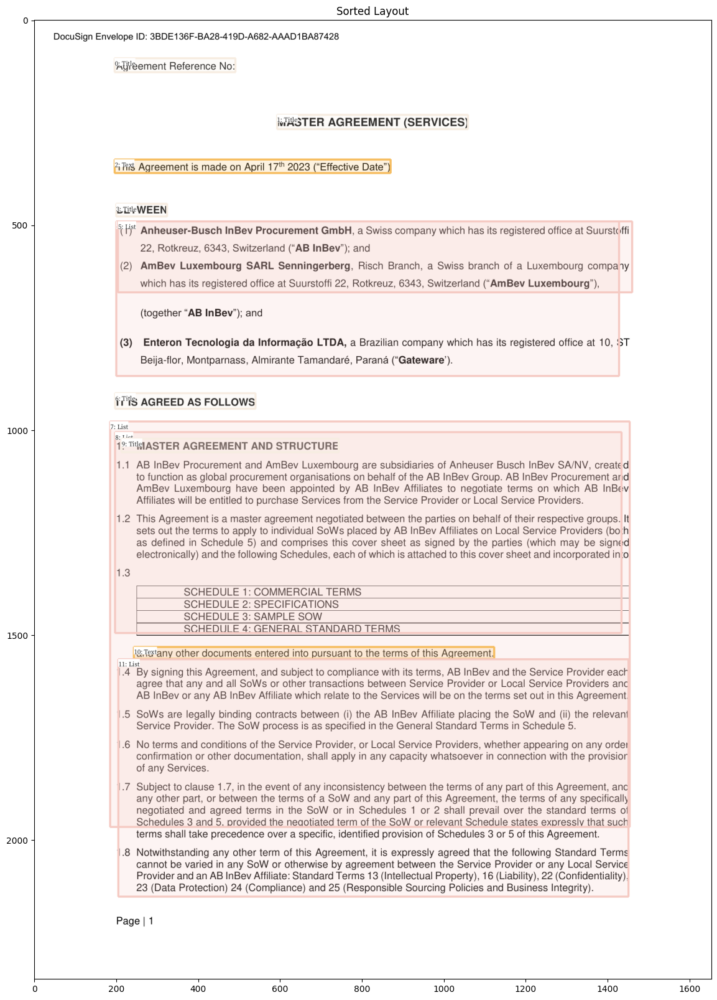

Processing page 2


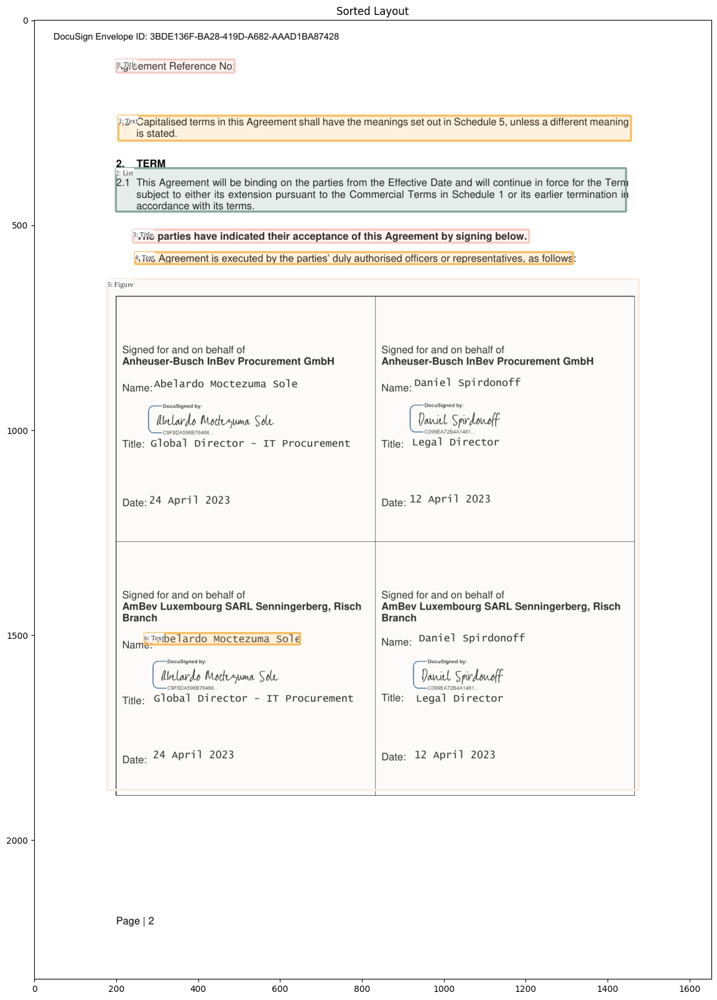

Processing page 3


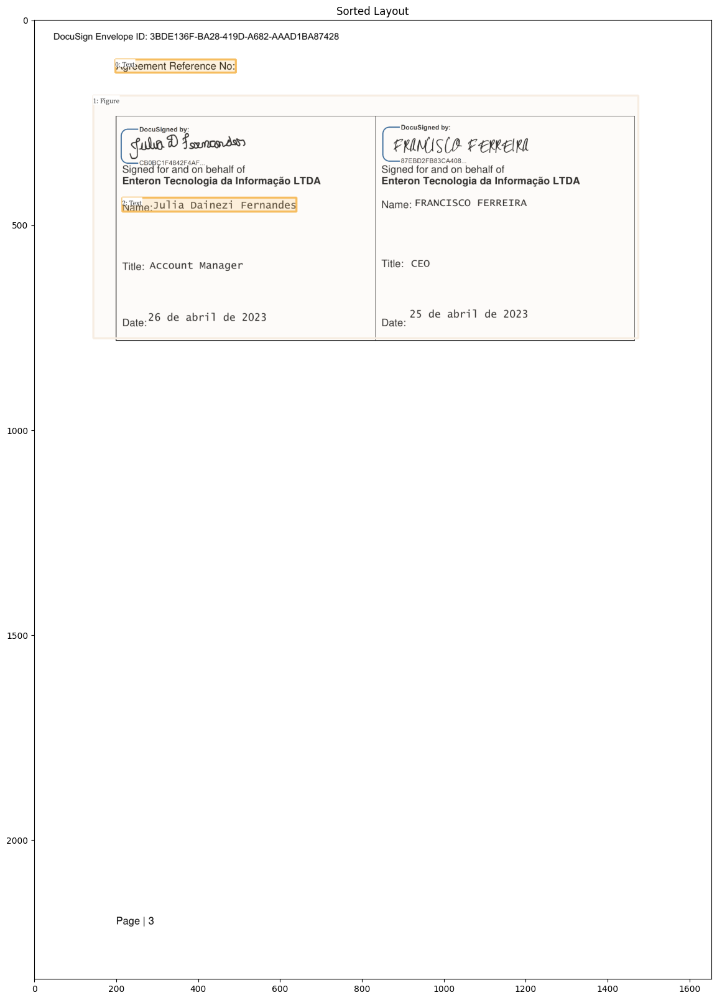

Processing page 4


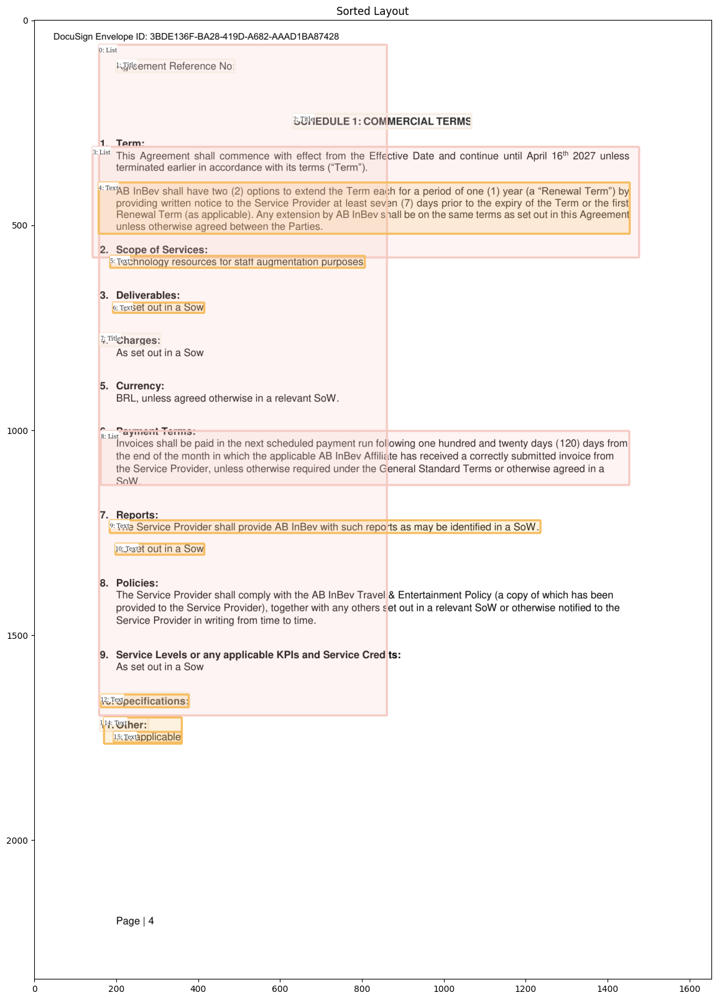

Processing page 5


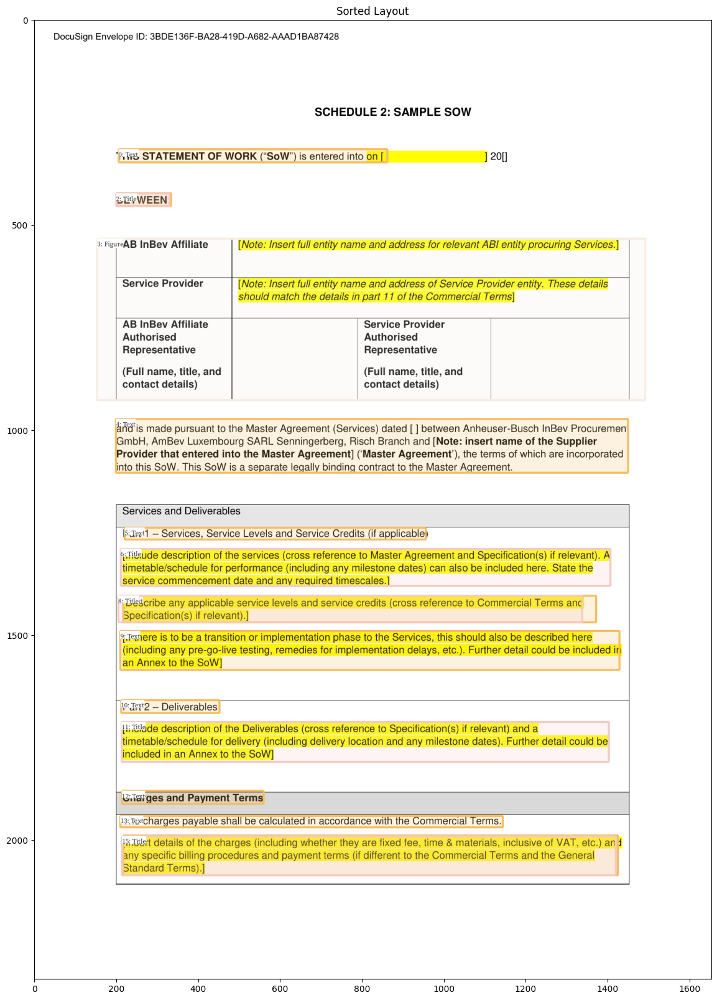

Processing page 6


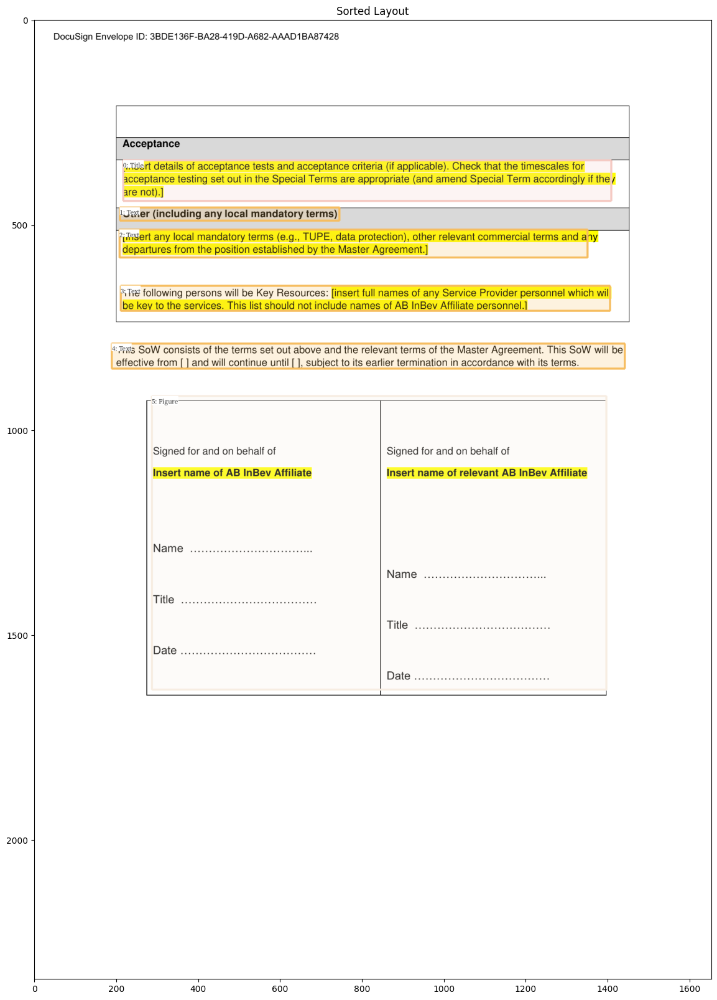

Processing page 7


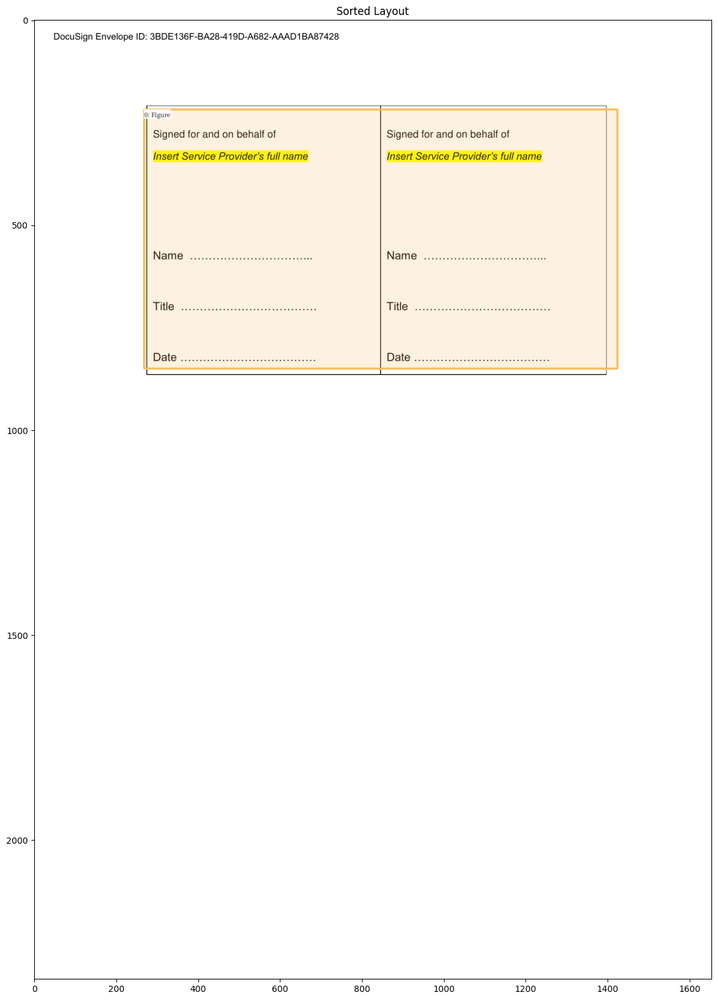

Processing page 8


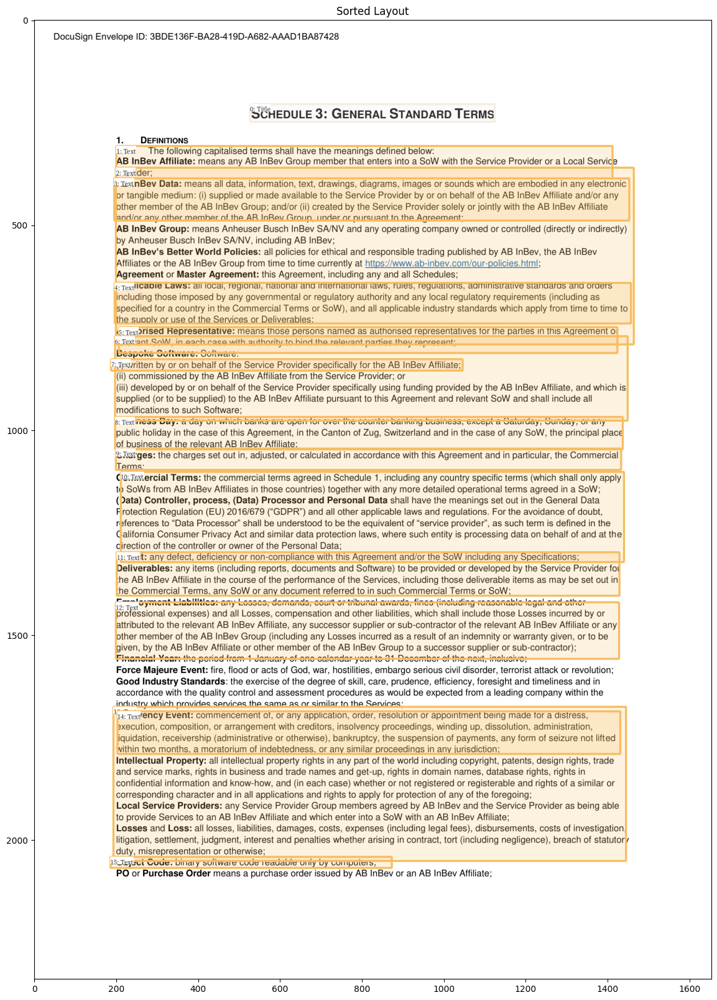

Processing page 9


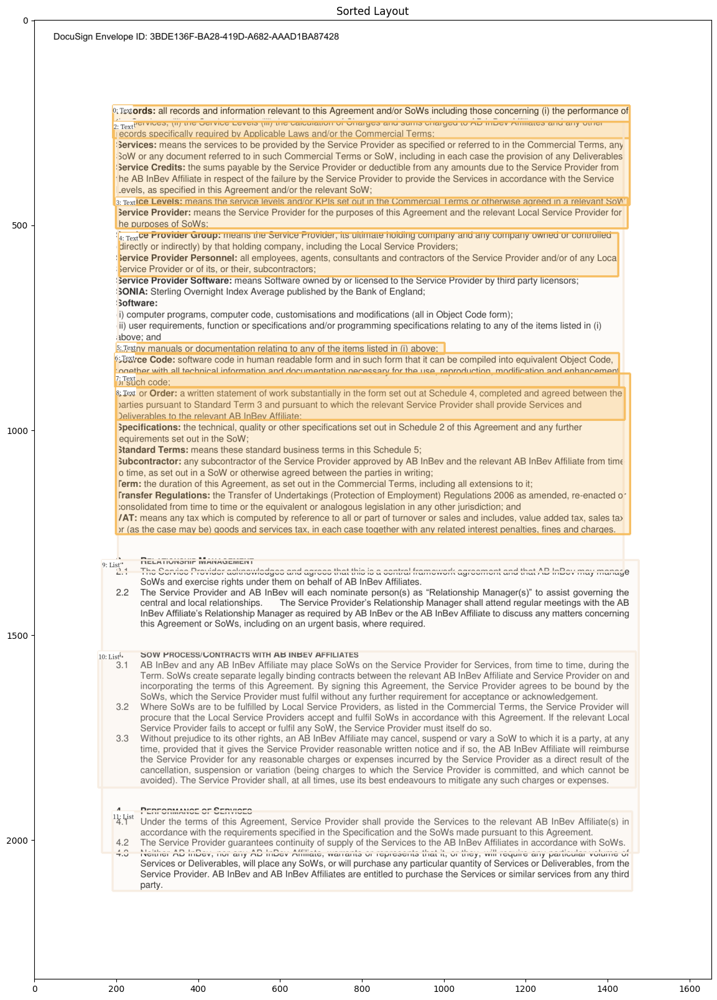

Processing page 10


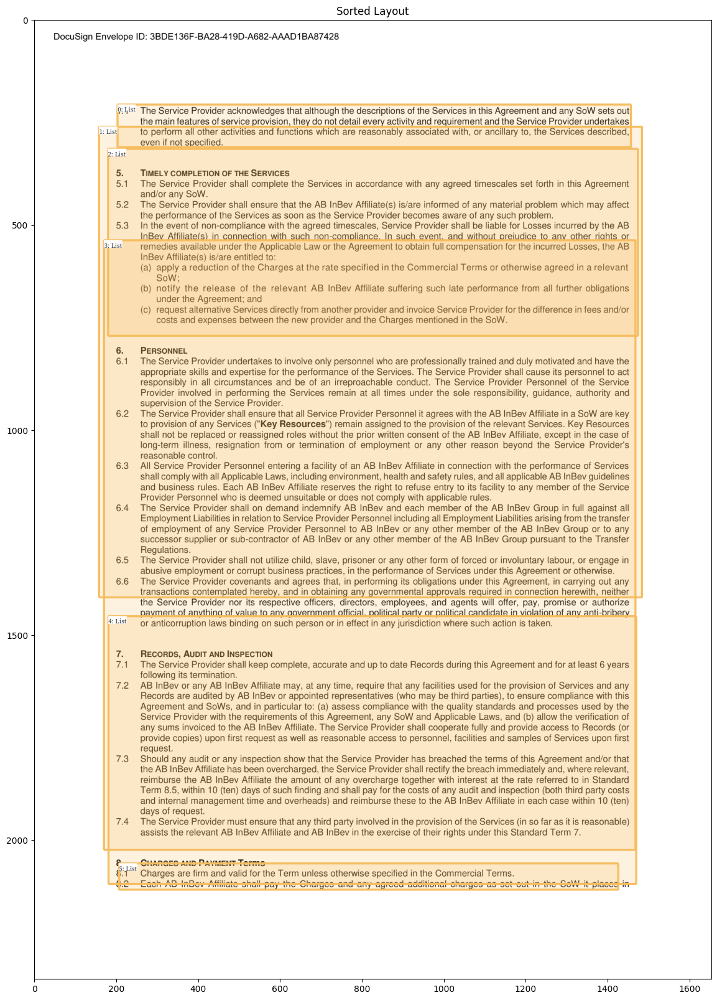

Processing page 11


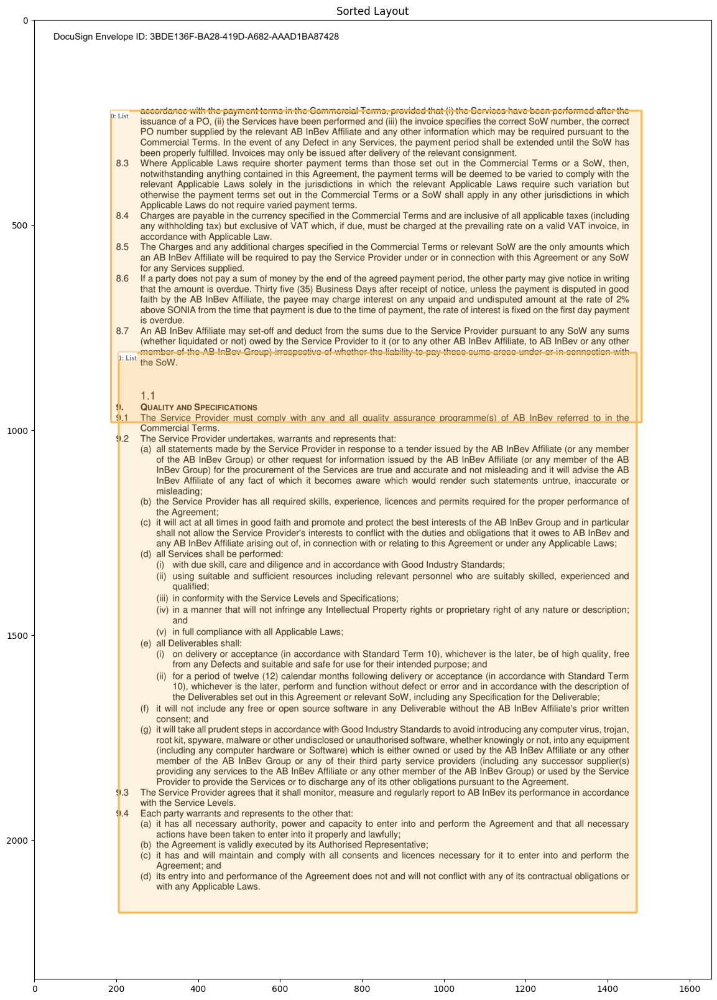

Processing page 12


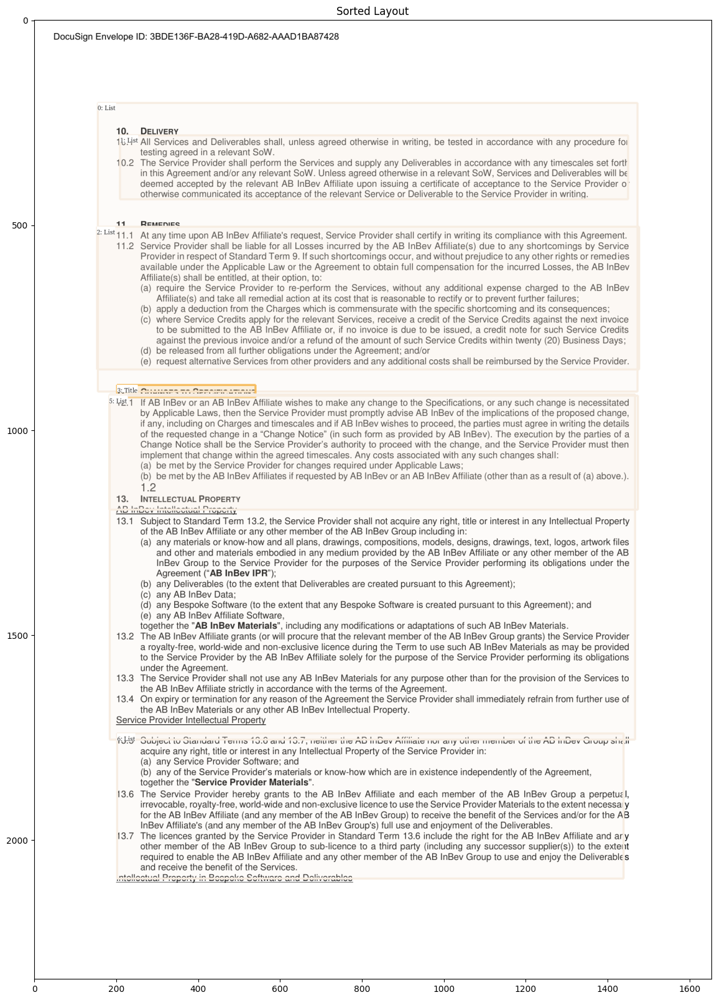

Processing page 13


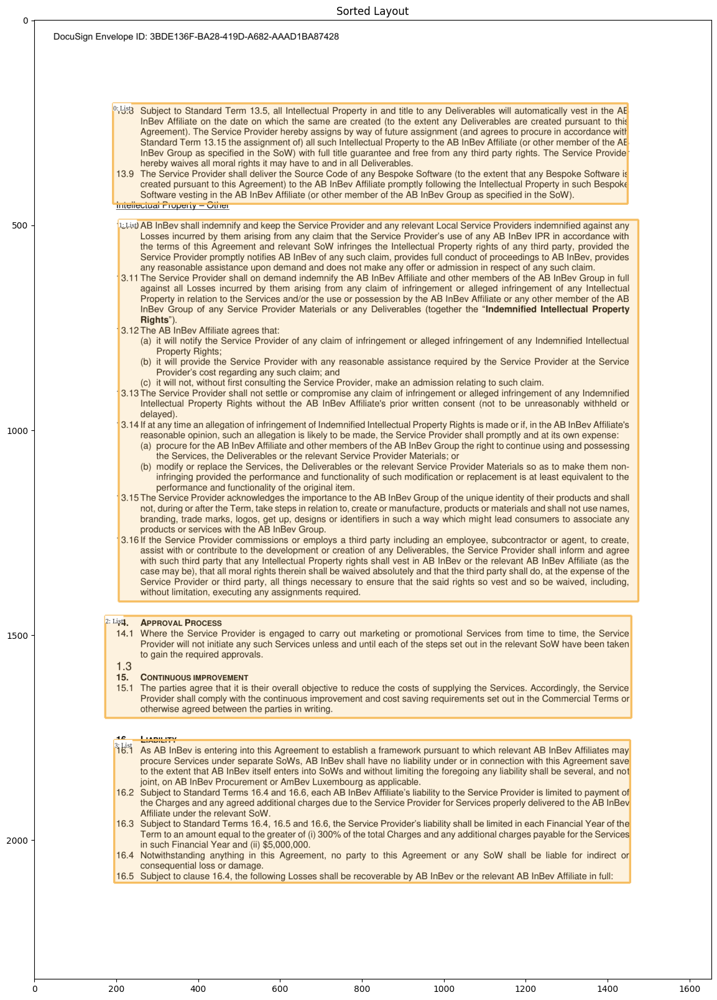

Processing page 14


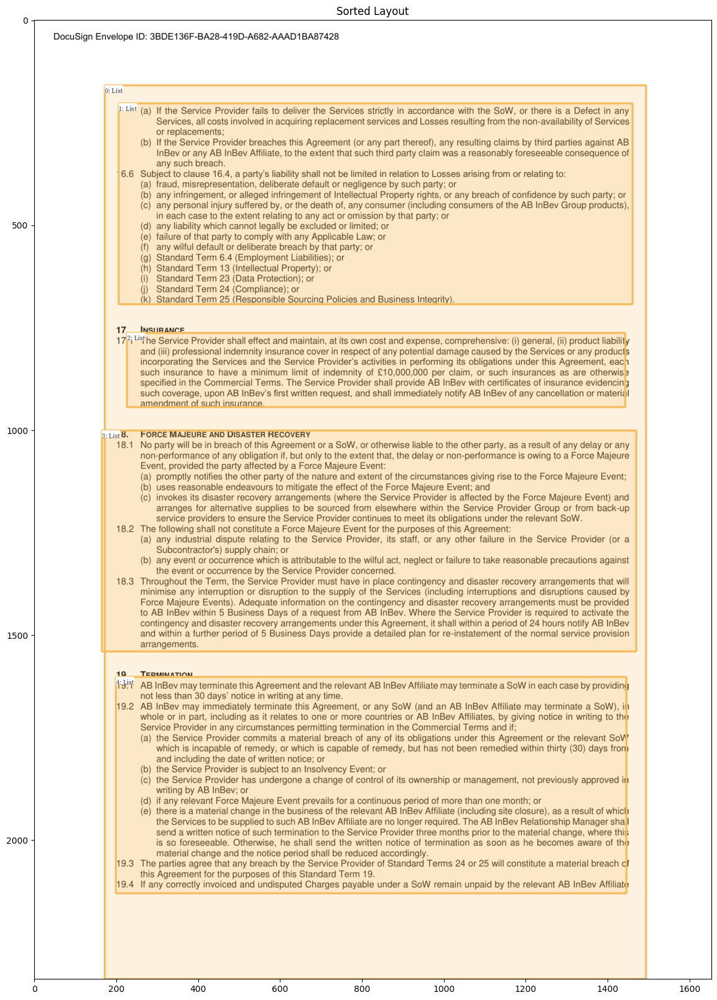

Processing page 15


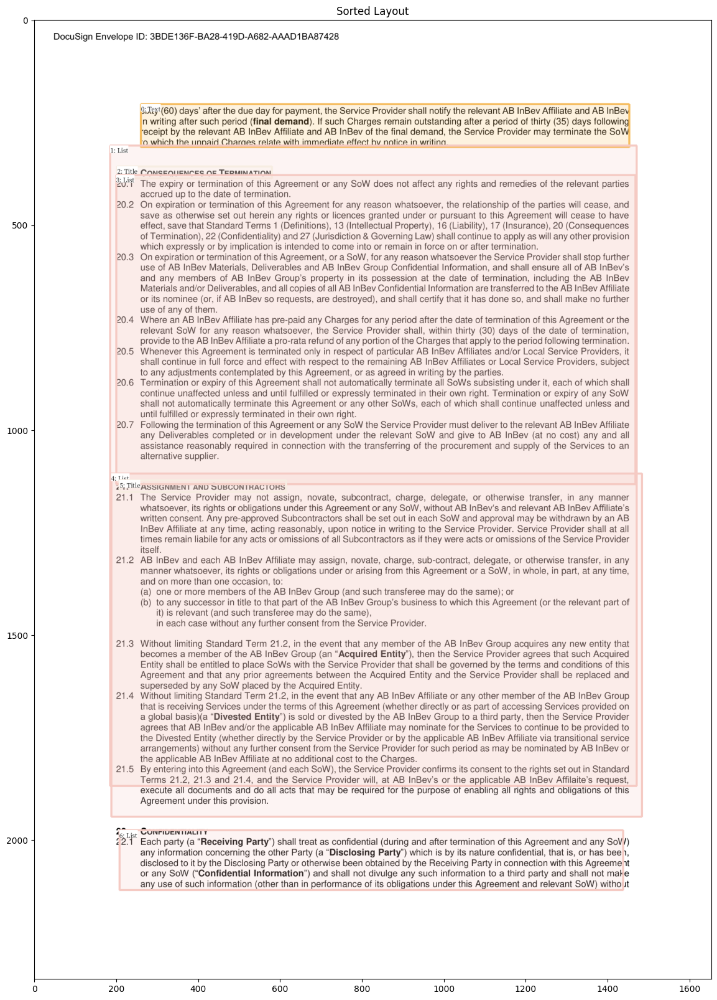

Processing page 16


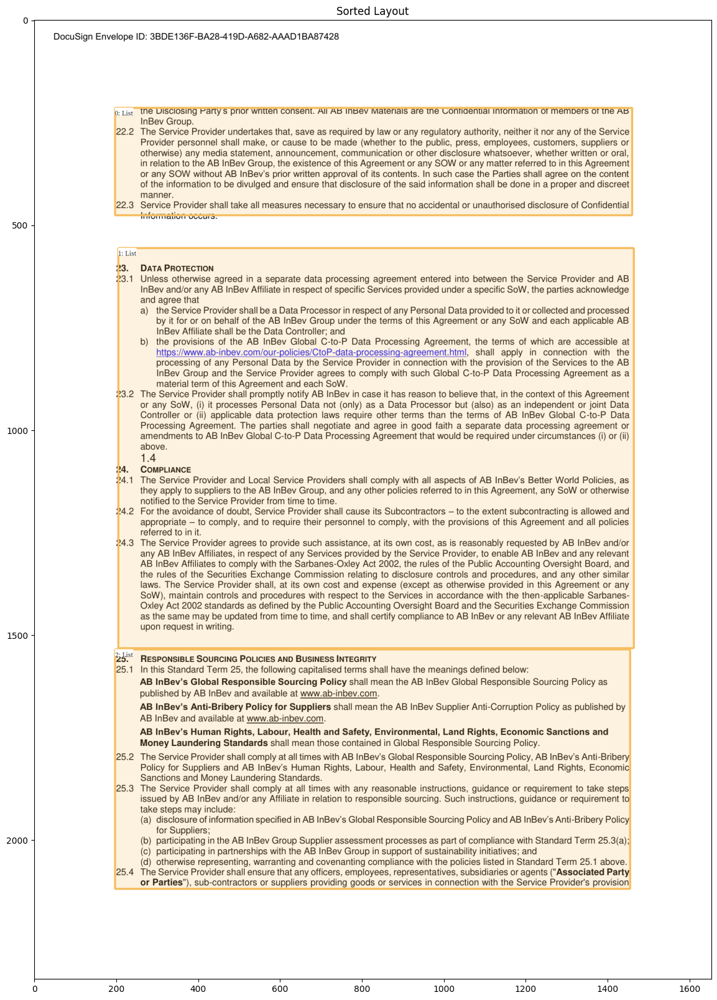

Processing page 17


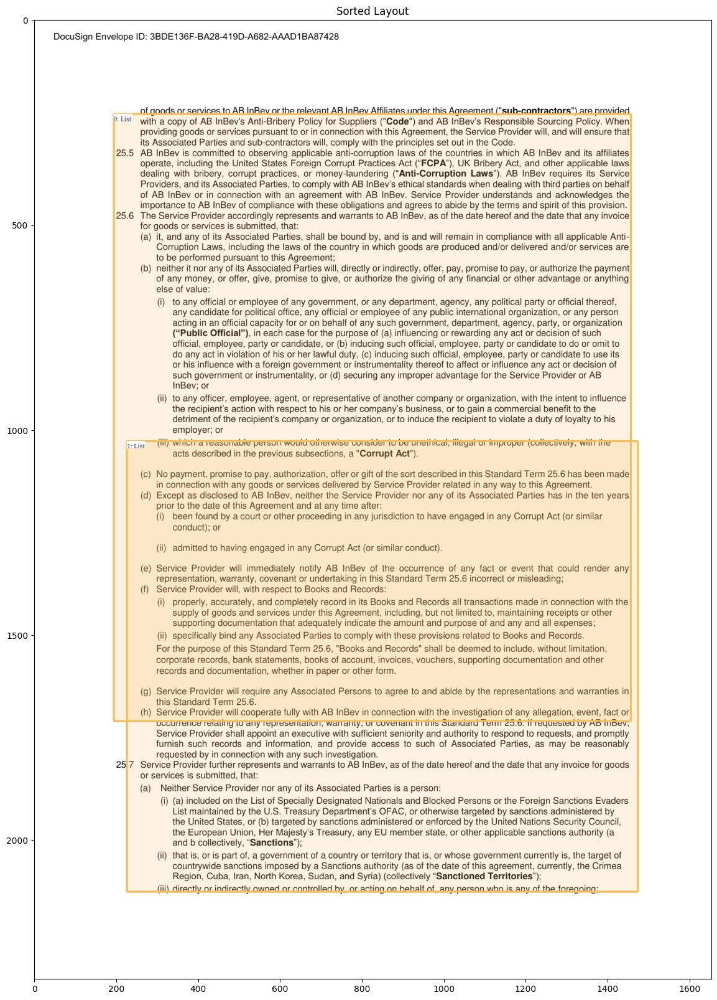

Processing page 18


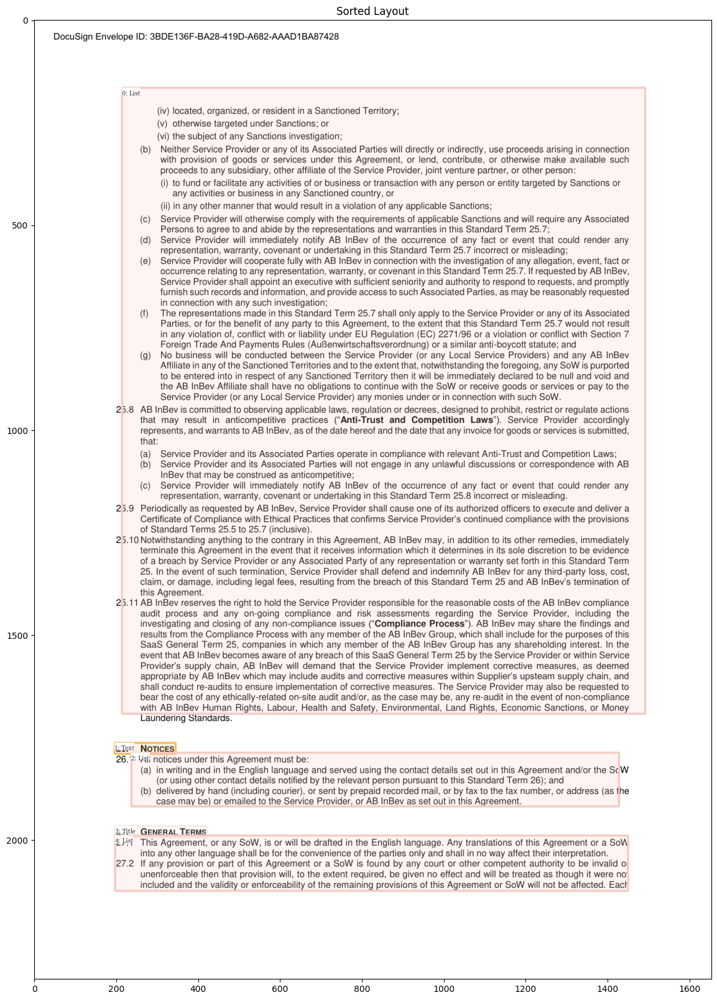

Processing page 19


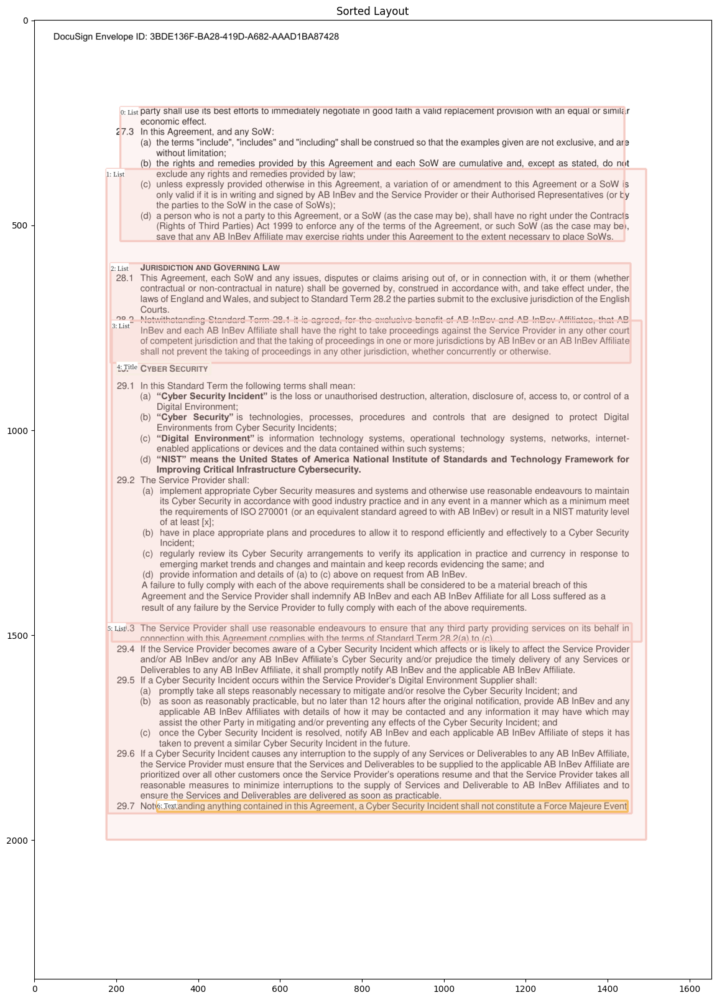

Processing page 20


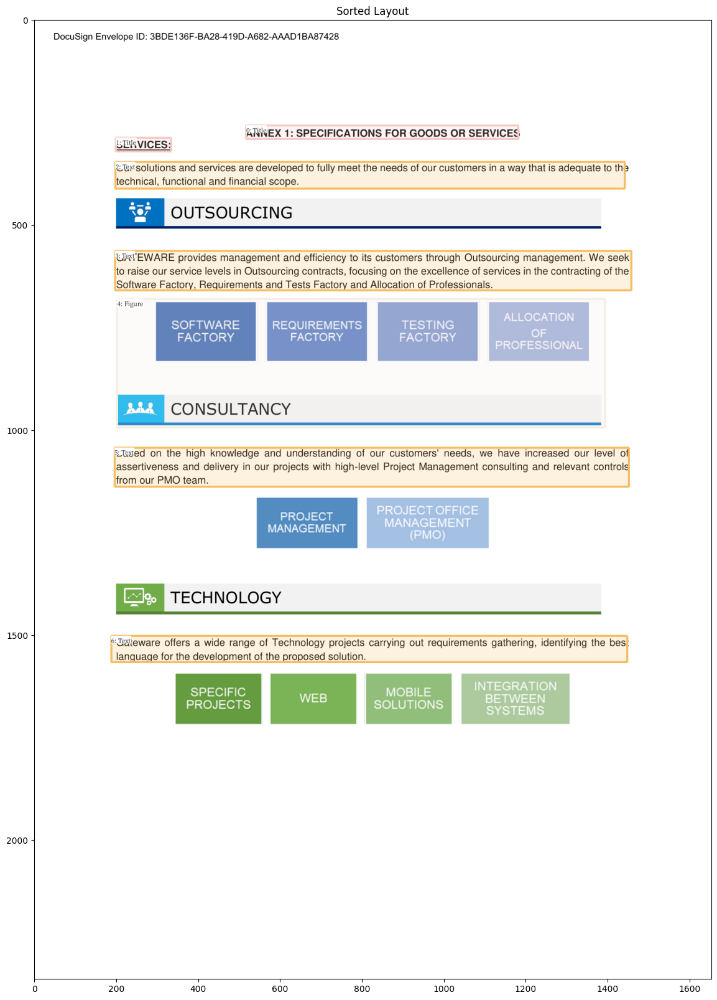

Processing page 21


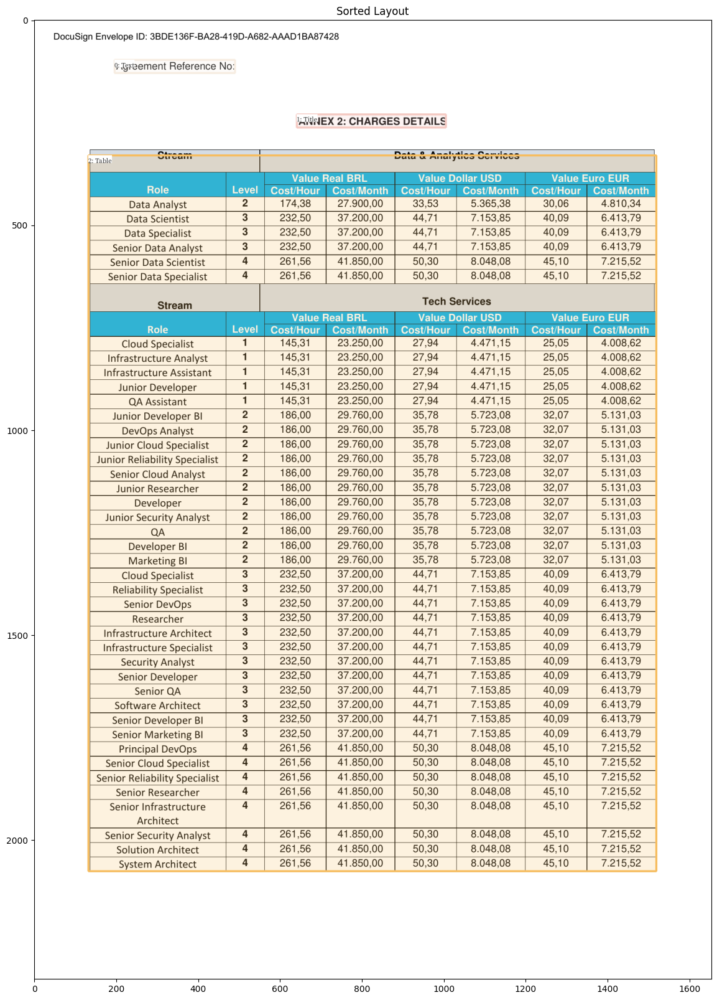

Processing page 22


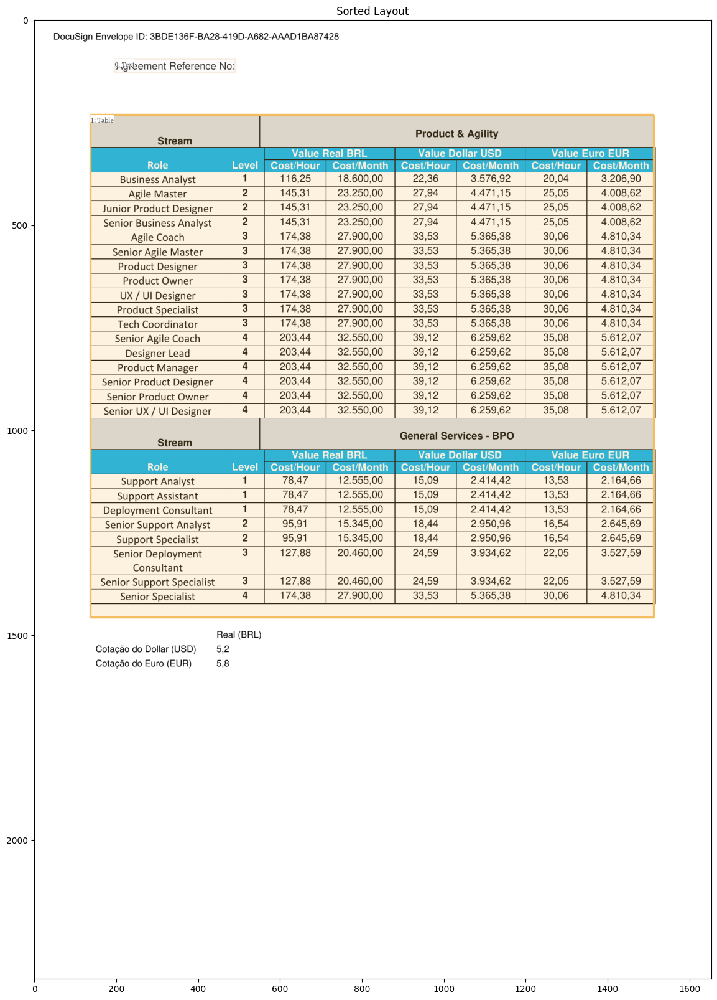

Processing page 23


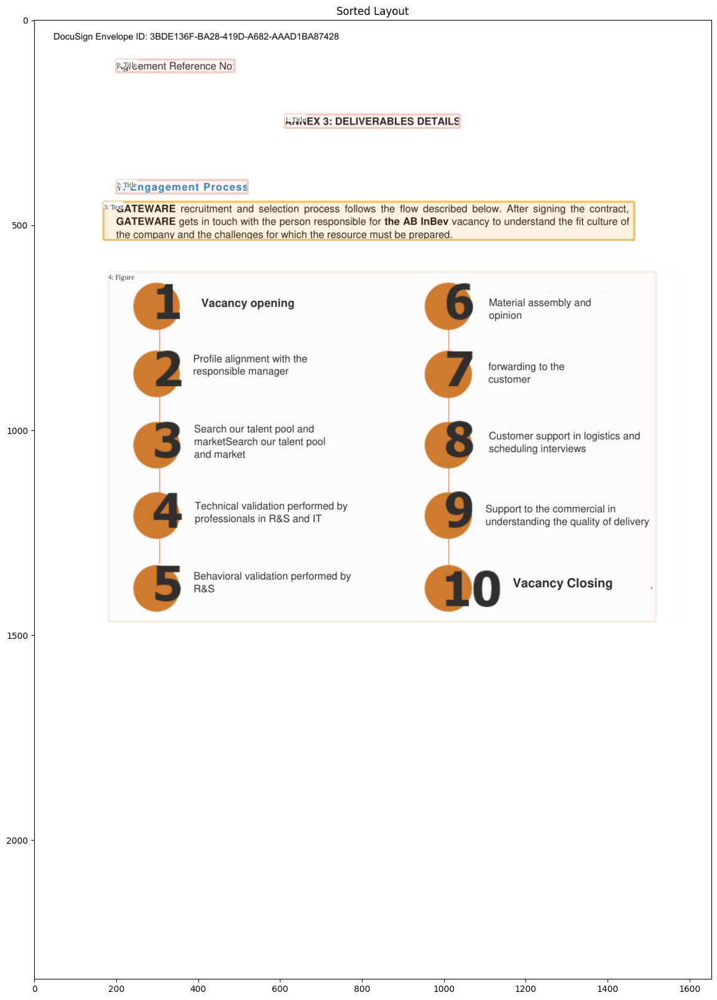

Processing page 24


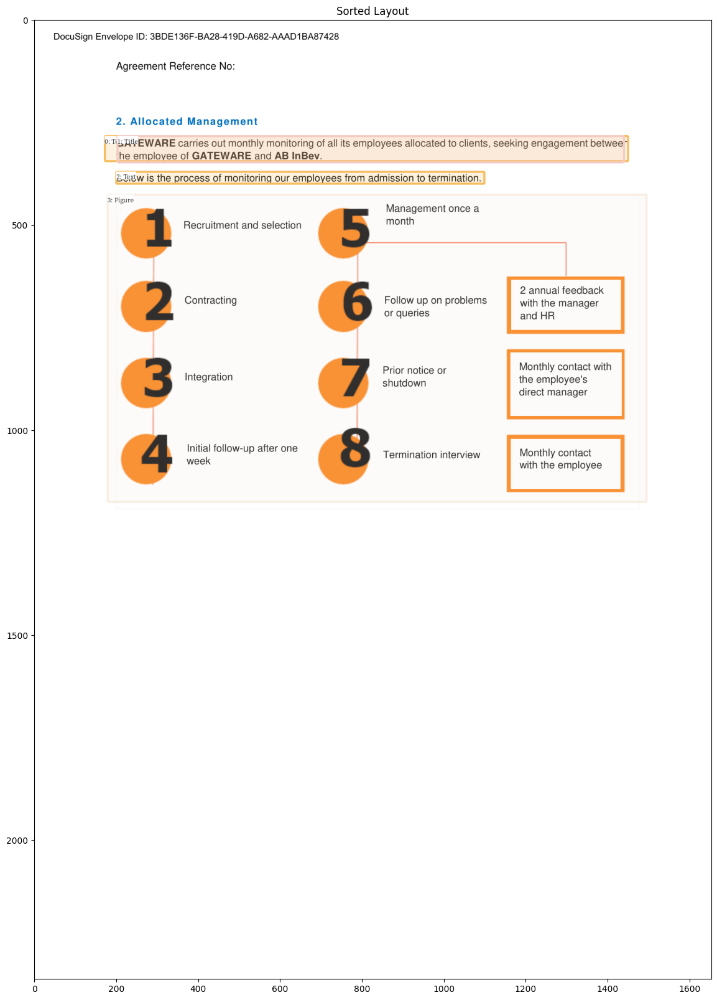

Processing page 25


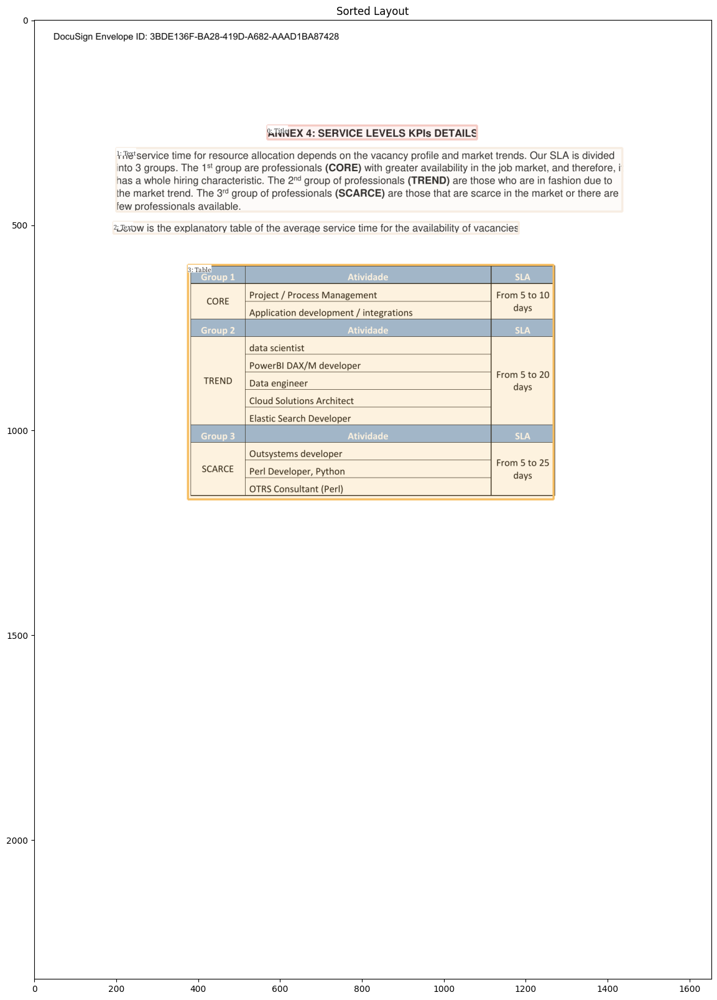

Processing page 26


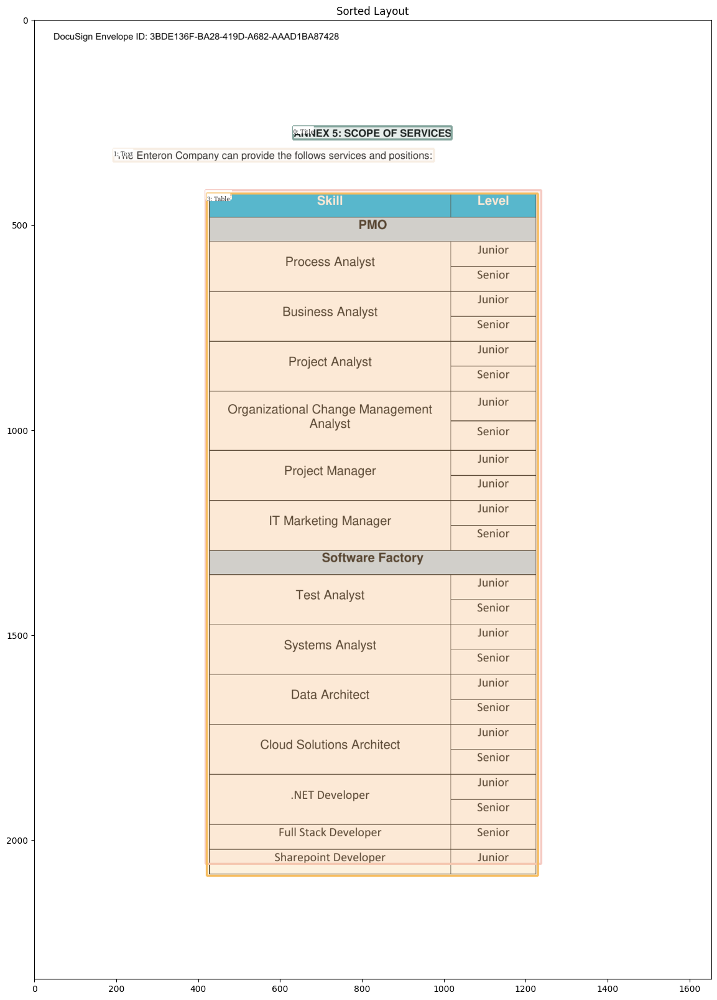

Processing page 27


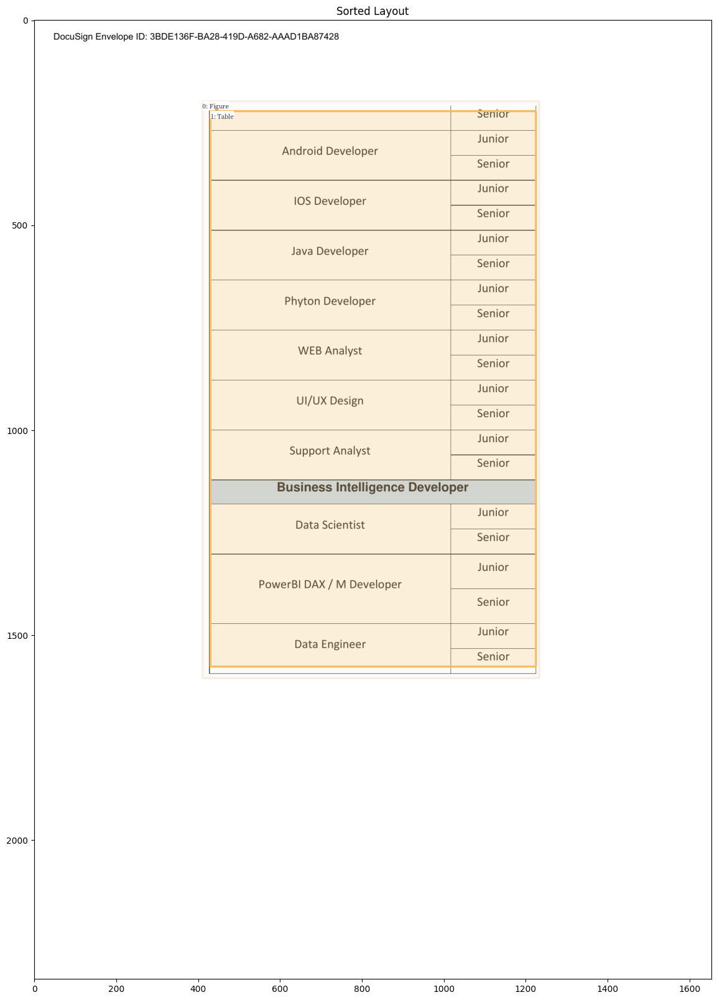

Processing page 28


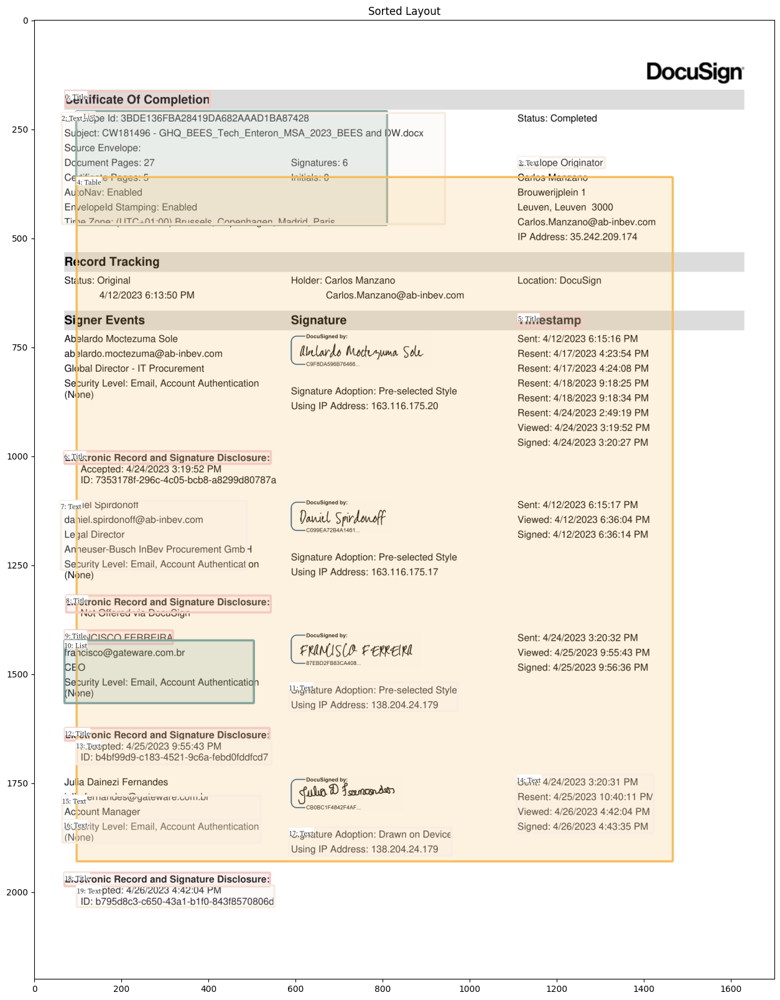

Processing page 29


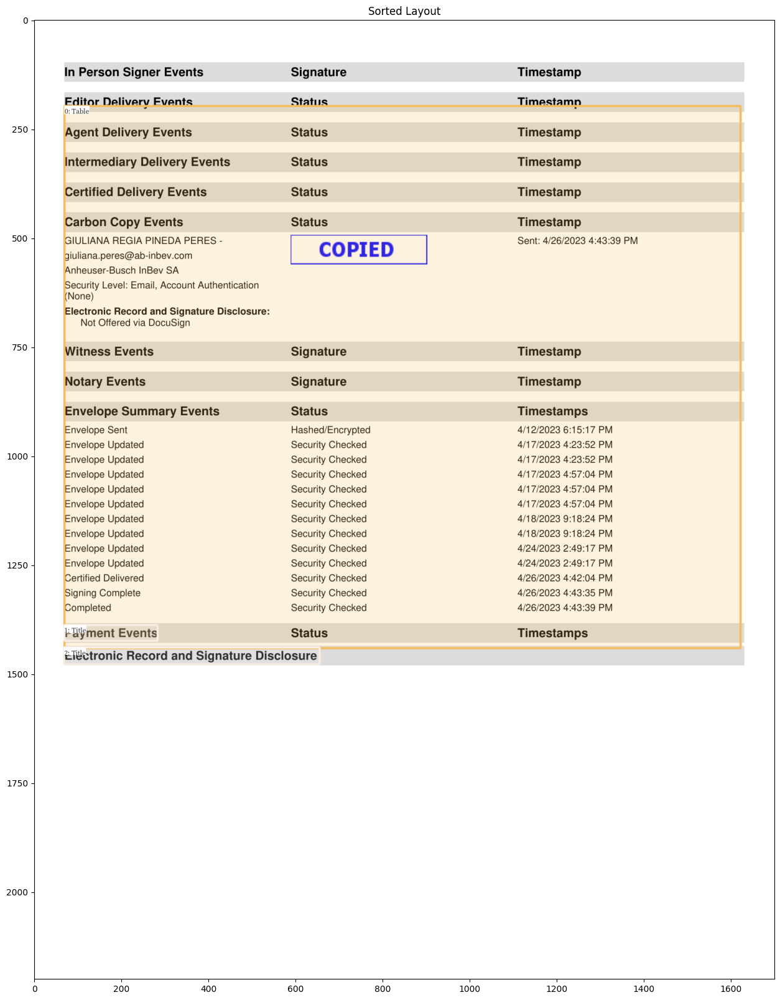

Processing page 30


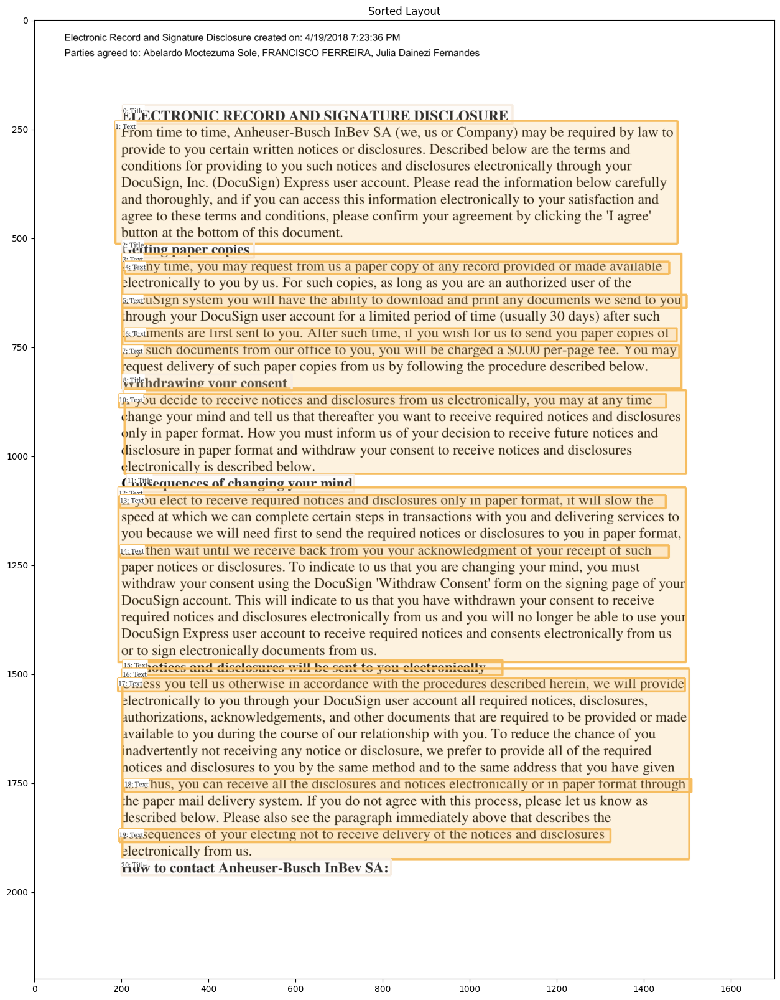

Processing page 31


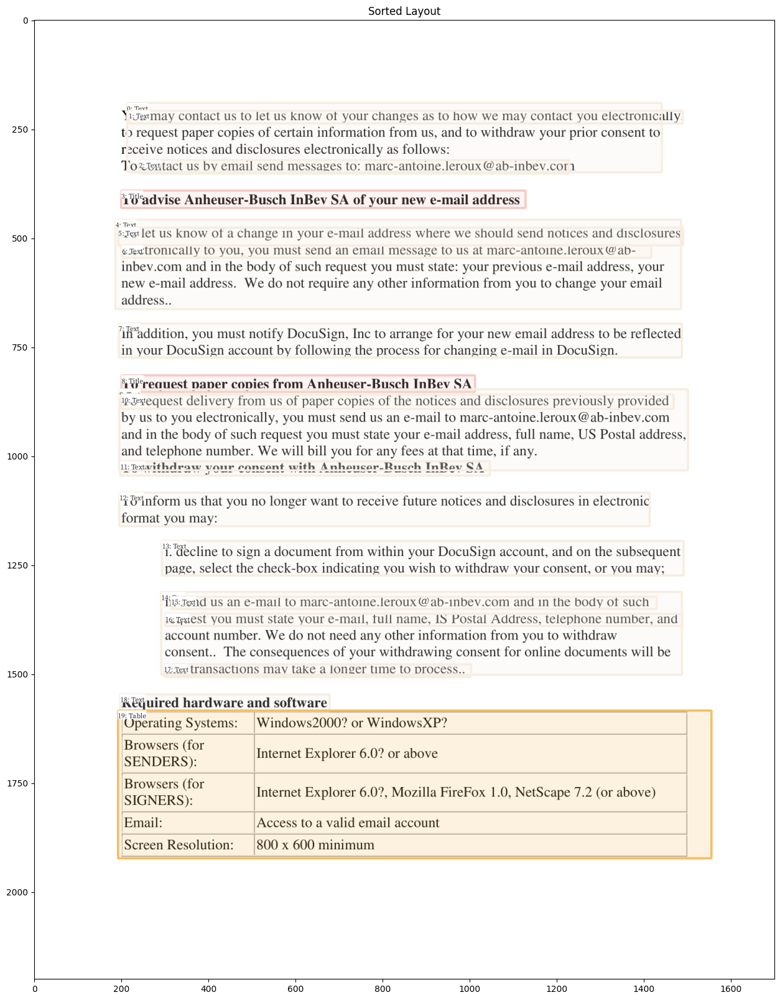

Processing page 32


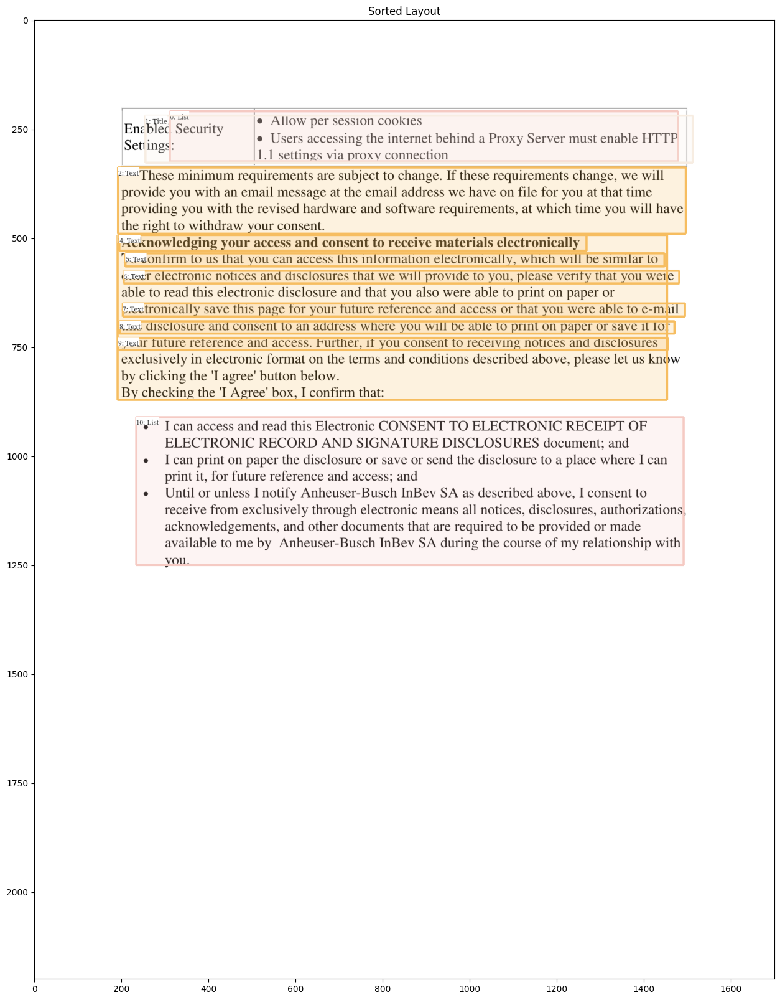

In [28]:
all_text = ""
for idx, page in enumerate(all_imgs):
    print(f"Processing page {idx+1}")
    page_text = image_to_text(page, ocr_agent)
    all_text += f"{page_text}\n\n"

In [29]:
print(all_text)

Agreement Reference No:
MASTER AGREEMENT (SERVICES)
This Agreement is made on April 17" 2023 (“Effective Date”)
BETWEEN
(1) Anheuser-Busch InBev Procurement GmbH, a Swiss company which has its registered office at Suurstof
22, Rotkreuz, 6343, Switzerland (“AB InBev’); and

(2) AmBev Luxembourg SARL Senningerberg, Risch Branch, a Swiss branch of a Luxembourg compan
which has its registered office at Suurstoffi 22, Rotkreuz, 6343, Switzerland (“AmBev Luxembourg’),

(together “AB InBev”); and

(3) Enteron Tecnologia da Informagao LTDA, a Brazilian company which has its registered office at 10, S
Beija-flor, Montparnass, Almirante Tamandaré, Parana (“Gateware’).
Anheuser-Busch InBev Procurement GmbH, a Swiss company which has its registered office at Suurstoffi
22, Rotkreuz, 6343, Switzerland (“AB InBev’); and

AmBev Luxembourg SARL Senningerberg, Risch Branch, a Swiss branch of a Luxembourg company
which has its registered office at Suurstoffi 22, Rotkreuz, 6343, Switzerland (“AmBev 

In [30]:
# #TODO:
# 1. List and Text are overlapping and even multiple list , we need to solve that issue
# 2. There are places where all the text are not properly captured, this needs also special attention
# 3. We have to minimize IOU for bounding boxes

########################################-------------------------------------------------------------########################################